In [1]:
import cv2
import os
from random import randrange
import numpy as np
import tensorflow as tf
import tensorflow.contrib.slim as slim
from tensorflow import keras 

import dlib
import argparse
import cv2
import time
import process_dlib_boxes
import face_recognition

from os import listdir
from os.path import isfile, join
from deepface import DeepFace
import matplotlib.pyplot as plt

C:\Users\DELL\anaconda3\envs\testenv\lib\site-packages\tensorflow\python\framework\dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
C:\Users\DELL\anaconda3\envs\testenv\lib\site-packages\tensorflow\python\framework\dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
C:\Users\DELL\anaconda3\envs\testenv\lib\site-packages\tensorflow\python\framework\dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
C:\Users\DELL\anaconda3\envs\testenv\lib\site-packages\tensorflow\pyth

In [2]:
df_path = 'D://SEM_7//FYP//DATASET//New//manipulated_sequences//Deepfakes//c23//videos'
df_list = os.listdir(df_path)
df_list

['000_003.mp4',
 '001_870.mp4',
 '002_006.mp4',
 '003_000.mp4',
 '004_982.mp4',
 '005_010.mp4',
 '006_002.mp4',
 '007_132.mp4',
 '008_990.mp4',
 '009_027.mp4',
 '010_005.mp4',
 '011_805.mp4',
 '012_026.mp4',
 '013_883.mp4',
 '014_790.mp4',
 '015_919.mp4',
 '016_209.mp4',
 '017_803.mp4',
 '018_019.mp4',
 '019_018.mp4',
 '020_344.mp4',
 '021_312.mp4',
 '022_489.mp4',
 '023_923.mp4',
 '024_073.mp4',
 '025_067.mp4',
 '026_012.mp4',
 '027_009.mp4',
 '028_068.mp4',
 '029_048.mp4',
 '030_193.mp4',
 '031_163.mp4',
 '032_944.mp4',
 '033_097.mp4',
 '034_590.mp4',
 '035_036.mp4',
 '036_035.mp4',
 '037_072.mp4',
 '038_125.mp4',
 '039_058.mp4',
 '040_997.mp4',
 '041_063.mp4',
 '042_084.mp4',
 '043_110.mp4',
 '044_945.mp4',
 '045_889.mp4',
 '046_904.mp4',
 '047_862.mp4',
 '048_029.mp4',
 '049_946.mp4',
 '050_059.mp4',
 '051_332.mp4',
 '052_108.mp4',
 '053_095.mp4',
 '054_071.mp4',
 '055_147.mp4',
 '056_996.mp4',
 '057_070.mp4',
 '058_039.mp4',
 '059_050.mp4',
 '060_088.mp4',
 '061_080.mp4',
 '062_06

In [15]:
df_list[0].split('.')[0]

'000_003'

In [3]:
len(df_list)

1000

In [3]:
real_path = "D://SEM_7//FYP//DATASET//New//original_sequences//youtube//c23//videos"
real_list = os.listdir(real_path)
real_list

['000.mp4',
 '001.mp4',
 '002.mp4',
 '003.mp4',
 '004.mp4',
 '005.mp4',
 '006.mp4',
 '007.mp4',
 '008.mp4',
 '009.mp4',
 '010.mp4',
 '011.mp4',
 '012.mp4',
 '013.mp4',
 '014.mp4',
 '015.mp4',
 '016.mp4',
 '017.mp4',
 '018.mp4',
 '019.mp4',
 '020.mp4',
 '021.mp4',
 '022.mp4',
 '023.mp4',
 '024.mp4',
 '025.mp4',
 '026.mp4',
 '027.mp4',
 '028.mp4',
 '029.mp4',
 '030.mp4',
 '031.mp4',
 '032.mp4',
 '033.mp4',
 '034.mp4',
 '035.mp4',
 '036.mp4',
 '037.mp4',
 '038.mp4',
 '039.mp4',
 '040.mp4',
 '041.mp4',
 '042.mp4',
 '043.mp4',
 '044.mp4',
 '045.mp4',
 '046.mp4',
 '047.mp4',
 '048.mp4',
 '049.mp4',
 '050.mp4',
 '051.mp4',
 '052.mp4',
 '053.mp4',
 '054.mp4',
 '055.mp4',
 '056.mp4',
 '057.mp4',
 '058.mp4',
 '059.mp4',
 '060.mp4',
 '061.mp4',
 '062.mp4',
 '063.mp4',
 '064.mp4',
 '065.mp4',
 '066.mp4',
 '067.mp4',
 '068.mp4',
 '069.mp4',
 '070.mp4',
 '071.mp4',
 '072.mp4',
 '073.mp4',
 '074.mp4',
 '075.mp4',
 '076.mp4',
 '077.mp4',
 '078.mp4',
 '079.mp4',
 '080.mp4',
 '081.mp4',
 '082.mp4',
 '08

In [5]:
len(real_list)

1000

In [4]:
output_path = "D:/SEM_7/FYP/Data"

In [5]:
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

In [5]:
if not os.path.exists(output_path + "/Frames"):
    os.mkdir(output_path + "/Frames")
    
if not os.path.exists(output_path + "/RGB/Real"):
    os.mkdir(output_path + "/RGB/Real")
    
if not os.path.exists(output_path + "/RGB/Deepfake"):
    os.mkdir(output_path + "/RGB/Deepfake")
    
if not os.path.exists(output_path + "/SRM/Real"):
    os.mkdir(output_path + "/SRM/Real")
    
if not os.path.exists(output_path + "/SRM/Deepfake"):
    os.mkdir(output_path + "/SRM/Deepfake") 

In [6]:
def srm(imgs):
    filter1 = [[0, 0, 0, 0, 0],
               [0, -1, 2, -1, 0],
               [0, 2, -4, 2, 0],
               [0, -1, 2, -1, 0],
               [0, 0, 0, 0, 0]]
    filter2 = [[-1, 2, -2, 2, -1],
               [2, -6, 8, -6, 2],
               [-2, 8, -12, 8, -2],
               [2, -6, 8, -6, 2],
               [-1, 2, -2, 2, -1]]
    filter3 = [[0, 0, 0, 0, 0],
               [0, 0, 0, 0, 0],
               [0, 1, -2, 1, 0],
               [0, 0, 0, 0, 0],
               [0, 0, 0, 0, 0]]
    
    q = [4.0, 12.0, 2.0]
    
    filter1 = np.asarray(filter1, dtype=float) / q[0]
    filter2 = np.asarray(filter2, dtype=float) / q[1]
    filter3 = np.asarray(filter3, dtype=float) / q[2]
    filters = [[filter1, filter1, filter1], [filter2, filter2, filter2], [filter3, filter3, filter3]]
    filters = np.einsum('klij->ijlk', filters)
    
    imgs = np.array(imgs, dtype=float)
    input = tf.Variable(imgs, dtype=tf.float32)

    filters = filters.flatten()
    initializer_srm = tf.constant_initializer(filters)
    op = slim.conv2d(input, 3, [5, 5], trainable=False, weights_initializer=initializer_srm,
                      activation_fn=None, padding='SAME', stride=1, scope='srm', reuse=tf.AUTO_REUSE)
    op = truncate_2(op)
    
    with tf.Session() as sess:
        sess.run(tf.initialize_all_variables())
        res = sess.run(op)
    
    ress = np.array(res, dtype=float)
    
    return res

def truncate_2(x):
    neg = ((x + 2) + abs(x + 2)) / 2 - 2
    return -(-neg+2 + abs(- neg+2)) / 2 + 2

def normalize(image):
    im = image.astype(float)
    return (im - np.min(im)) / (np.max(im) - np.min(im))

In [7]:
def get_data(location,data_list,vid_type):
    m = 8
    n = 1

    for i in range(len(data_list)):
        media = data_list[i]
        cap = cv2.VideoCapture (location + "/"+ media)
        tot = cap.get(cv2.CAP_PROP_FRAME_COUNT)    
#         print(tot)
#         media = real_list[i]
        print("processing " +media.split('.')[0]+ ".mp4")
        dest = output_path + "/RGB/" + str(vid_type) + "/" +media.split('.')[0]
        dest_srm = output_path + "/SRM/"+ str(vid_type) + "/"+ media.split('.')[0]
        if not os.path.exists(dest):
            os.mkdir(dest)
        if not os.path.exists(dest_srm):
            os.mkdir(dest_srm)

        frames = []
        for i in range(m):
    #         print("Segment", i)
            if not os.path.exists(output_path + "/Frames/"+media.split('.')[0]):
                os.mkdir(output_path + "/Frames/"+media.split('.')[0])
            if not os.path.exists(output_path + "/Frames/"+media.split('.')[0]+"/Segment"+str(i)+"/"):
                os.mkdir(output_path + "/Frames/"+media.split('.')[0]+"/Segment"+str(i)+"/")
            for j in range(n):
                x = randrange(round((tot/m)*i), round((tot/m)*(i+1)))
                frames.append(x)
    #             print('Frame: ', x, '\n')

        cnt1 = 0
        cnt2 = 0
        while cap.isOpened():
            frameId = cap.get(1)
            ret, frame = cap.read()
            if ret != True:
                break
            if frameId in frames:
                cv2.imwrite(output_path + "/Frames/"+media.split('.')[0]+"/Segment"+str(cnt1)+'/'+media.split('.')[0]+'_'+
                            str(cnt1)+str(cnt2)+'.png', frame)
                cnt2 += 1
                if cnt2 == n:
                    cnt2 = 0
                    cnt1 += 1

        path = output_path + "/Frames/"+media.split('.')[0]+"/Segment"
        save_name = ''
        for i in range(m):
            mypath = path + str(i)
            onlyfiles = [f for f in listdir(mypath) if isfile(join(mypath, f))]
            if (len(onlyfiles)>0):
                inp = onlyfiles[0]

                if not os.path.exists(output_path+"/RGB/" + vid_type + "/" +media.split('.')[0]):
                    os.mkdir(output_path+"/RGB/" + vid_type + "/" +media.split('.')[0])

                # read the image and convert to RGB color format
                image = cv2.imread(path+str(i)+"/"+inp)
                image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

                # path for saving the result image
                save_name = dest+"/"+inp.split('/')[-1].split('.')[0]+".png"
                # face location extraction
                face_locations = face_recognition.face_locations(image_rgb)

                aligned_face = DeepFace.detectFace(image,target_size=(299,299),detector_backend = 'dlib')
    #             print(type(aligned_face))
                plt.imshow(aligned_face)
                plt.imsave(save_name, aligned_face)
    #             cv2.imwrite(save_name, aligned_face)

            else:
                break

        fig = plt.figure(figsize=(16,9))
        faces = []
        for i in range(m):
            img = cv2.cvtColor (cv2.imread(dest+"/"+media.split('.')[0]+'_'+str(i)+'0'+'.png'), cv2.COLOR_BGR2RGB)
            faces.append(img)
            fig.add_subplot(4,2,i+1)
            plt.xlabel(str(i)+'.png', fontsize = 10)
            plt.imshow(np.squeeze(img))
            ax = plt.gca()
            ax.axes.xaxis.set_ticks([])
            ax.axes.yaxis.set_ticks([])
    #     plt.show;

        fig = plt.figure(figsize=(16,9))
        noise_maps = []
        for i in range(m):
            img = srm([faces[i]])
            noise_maps.append(normalize(img[0]))
    #         if not os.path.exists("NoiseMaps/"):
    #             os.mkdir("NoiseMaps/")
    #         if not os.path.exists("NoiseMaps/"+media.split('.')[0]):
    #             os.mkdir("NoiseMaps/"+media.split('.')[0])
            pic = cv2.cvtColor ((noise_maps[i]*255).astype(np.uint8), cv2.COLOR_RGB2BGR)
            cv2.imwrite(dest_srm+'/'+str(i)+'.png', pic)

#             fig.add_subplot(2,2,1)
#             plt.title('RGB Stream Sample', fontsize = 20)
#             plt.imshow(faces[i])
#             ax = plt.gca()
#             ax.axes.xaxis.set_ticks([])
#             ax.axes.yaxis.set_ticks([])

#             fig.add_subplot(2,2,2)
#             plt.title('SRM Stream Sample', fontsize = 20)
#             plt.imshow(noise_maps[i])
#             ax = plt.gca()
#             ax.axes.xaxis.set_ticks([])
#             ax.axes.yaxis.set_ticks([])
#             plt.show();
        print("\nCompleted")

In [11]:
import warnings
warnings.filterwarnings('ignore')

# Real

In [8]:
real_list = real_list[386:]
real_list

['386.mp4',
 '387.mp4',
 '388.mp4',
 '389.mp4',
 '390.mp4',
 '391.mp4',
 '392.mp4',
 '393.mp4',
 '394.mp4',
 '395.mp4',
 '396.mp4',
 '397.mp4',
 '398.mp4',
 '399.mp4',
 '400.mp4',
 '401.mp4',
 '402.mp4',
 '403.mp4',
 '404.mp4',
 '405.mp4',
 '406.mp4',
 '407.mp4',
 '408.mp4',
 '409.mp4',
 '410.mp4',
 '411.mp4',
 '412.mp4',
 '413.mp4',
 '414.mp4',
 '415.mp4',
 '416.mp4',
 '417.mp4',
 '418.mp4',
 '419.mp4',
 '420.mp4',
 '421.mp4',
 '422.mp4',
 '423.mp4',
 '424.mp4',
 '425.mp4',
 '426.mp4',
 '427.mp4',
 '428.mp4',
 '429.mp4',
 '430.mp4',
 '431.mp4',
 '432.mp4',
 '433.mp4',
 '434.mp4',
 '435.mp4',
 '436.mp4',
 '437.mp4',
 '438.mp4',
 '439.mp4',
 '440.mp4',
 '441.mp4',
 '442.mp4',
 '443.mp4',
 '444.mp4',
 '445.mp4',
 '446.mp4',
 '447.mp4',
 '448.mp4',
 '449.mp4',
 '450.mp4',
 '451.mp4',
 '452.mp4',
 '453.mp4',
 '454.mp4',
 '455.mp4',
 '456.mp4',
 '457.mp4',
 '458.mp4',
 '459.mp4',
 '460.mp4',
 '461.mp4',
 '462.mp4',
 '463.mp4',
 '464.mp4',
 '465.mp4',
 '466.mp4',
 '467.mp4',
 '468.mp4',
 '46

processing 386.mp4
Instructions for updating:
Use `tf.global_variables_initializer` instead.



Completed
processing 387.mp4



Completed
processing 388.mp4



Completed
processing 389.mp4



Completed
processing 390.mp4



Completed
processing 391.mp4



Completed
processing 392.mp4



Completed
processing 393.mp4



Completed
processing 394.mp4



Completed
processing 395.mp4



Completed
processing 396.mp4



Completed
processing 397.mp4



Completed
processing 398.mp4



Completed
processing 399.mp4



Completed
processing 400.mp4



Completed
processing 401.mp4



Completed
processing 402.mp4



Completed
processing 403.mp4



Completed
processing 404.mp4



Completed
processing 405.mp4



Completed
processing 406.mp4



Completed
processing 407.mp4



Completed
processing 408.mp4



Completed
processing 409.mp4



Completed
processing 410.mp4



Completed
processing 411.mp4



Completed
processing 412.mp4



Completed
processing 413.mp4



Completed
processing 414.mp4



Completed
processing 415.mp4



Completed
processing 416.mp4



Completed
processing 417.mp4



Completed
processing 418.mp4



Completed
processing 419.mp4



Completed
processing 420.mp4



Completed
processing 421.mp4



Completed
processing 422.mp4



Completed
processing 423.mp4



Completed
processing 424.mp4



Completed
processing 425.mp4



Completed
processing 426.mp4



Completed
processing 427.mp4



Completed
processing 428.mp4



Completed
processing 429.mp4



Completed
processing 430.mp4



Completed
processing 431.mp4



Completed
processing 432.mp4



Completed
processing 433.mp4



Completed
processing 434.mp4



Completed
processing 435.mp4



Completed
processing 436.mp4



Completed
processing 437.mp4



Completed
processing 438.mp4



Completed
processing 439.mp4



Completed
processing 440.mp4



Completed
processing 441.mp4



Completed
processing 442.mp4



Completed
processing 443.mp4



Completed
processing 444.mp4



Completed
processing 445.mp4



Completed
processing 446.mp4



Completed
processing 447.mp4



Completed
processing 448.mp4



Completed
processing 449.mp4



Completed
processing 450.mp4



Completed
processing 451.mp4


KeyboardInterrupt: 

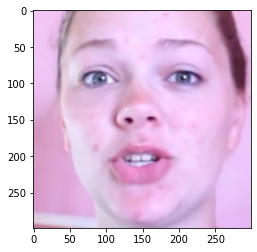

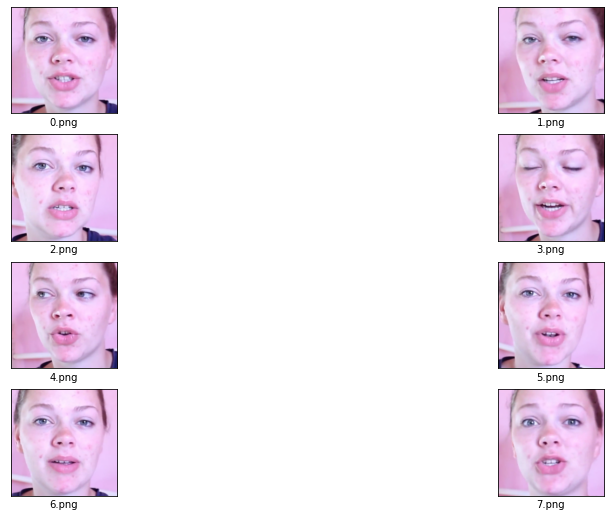

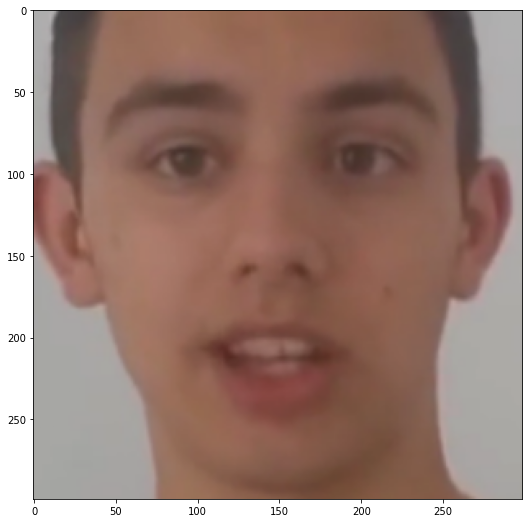

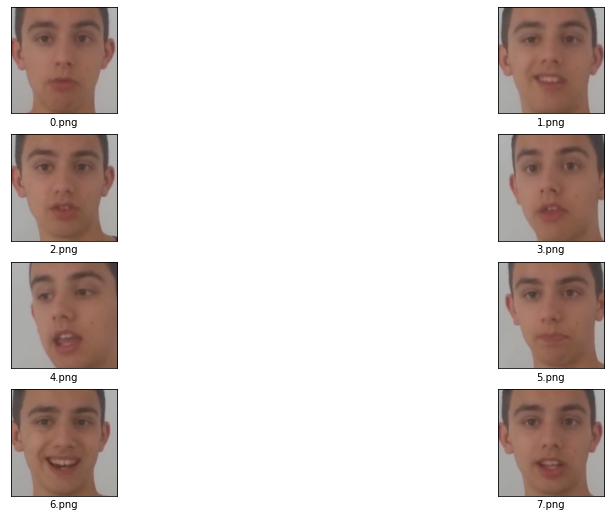

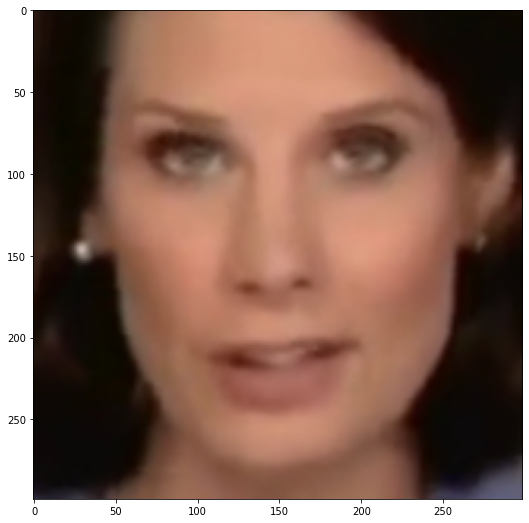

...

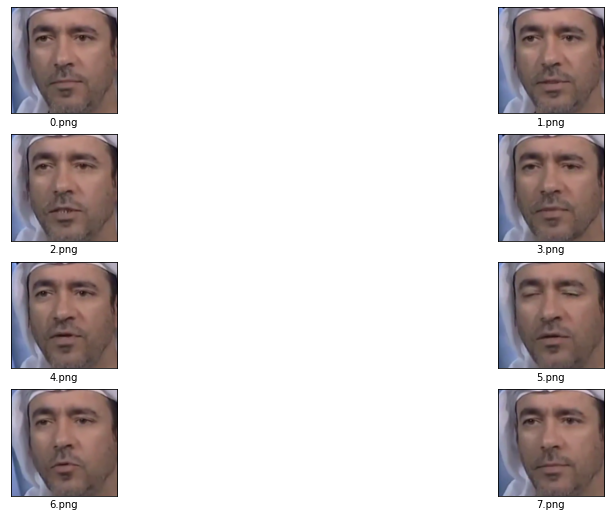

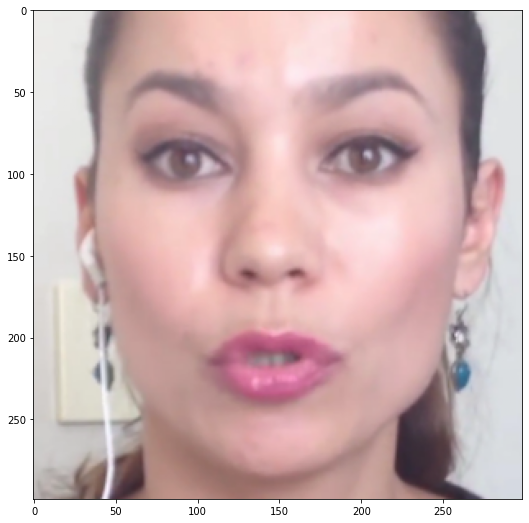

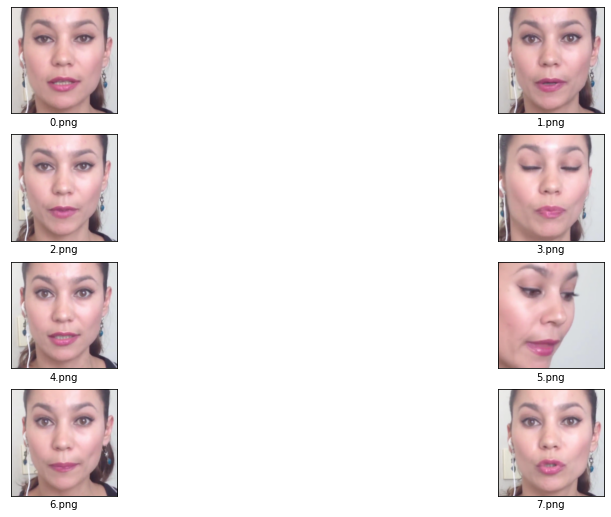

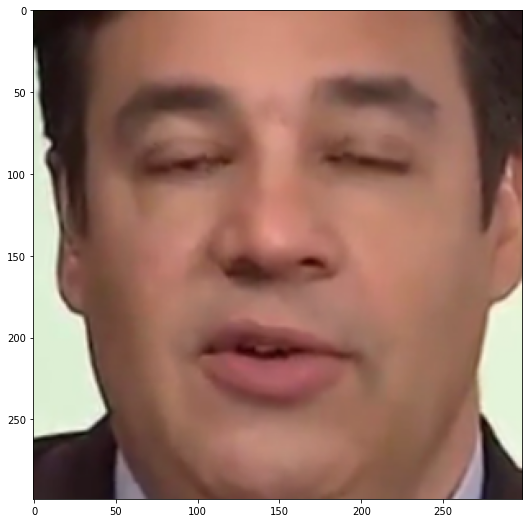

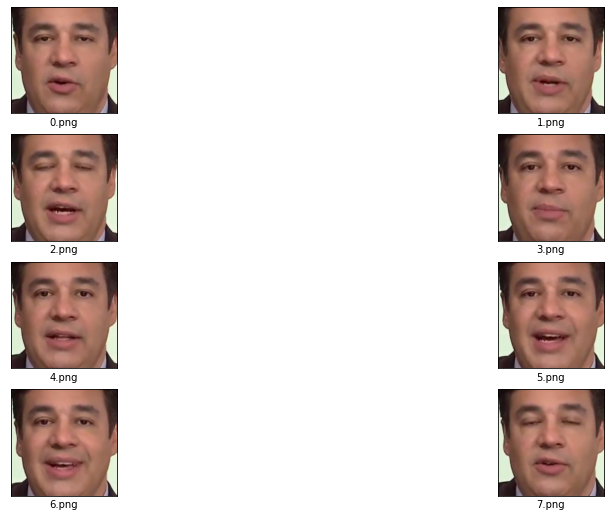

<Figure size 1152x648 with 0 Axes>

In [9]:
get_data(real_path,real_list,vid_type="Real")

In [15]:
df_list = df_list[80:]
df_list

['080_061.mp4',
 '081_087.mp4',
 '082_103.mp4',
 '083_213.mp4',
 '084_042.mp4',
 '085_124.mp4',
 '086_090.mp4',
 '087_081.mp4',
 '088_060.mp4',
 '089_065.mp4',
 '090_086.mp4',
 '091_116.mp4',
 '092_098.mp4',
 '093_121.mp4',
 '094_111.mp4',
 '095_053.mp4',
 '096_101.mp4',
 '097_033.mp4',
 '098_092.mp4',
 '099_295.mp4',
 '100_077.mp4',
 '101_096.mp4',
 '102_114.mp4',
 '103_082.mp4',
 '104_126.mp4',
 '105_180.mp4',
 '106_198.mp4',
 '107_109.mp4',
 '108_052.mp4',
 '109_107.mp4',
 '110_043.mp4',
 '111_094.mp4',
 '112_892.mp4',
 '113_983.mp4',
 '114_102.mp4',
 '115_939.mp4',
 '116_091.mp4',
 '117_217.mp4',
 '118_120.mp4',
 '119_123.mp4',
 '120_118.mp4',
 '121_093.mp4',
 '122_144.mp4',
 '123_119.mp4',
 '124_085.mp4',
 '125_038.mp4',
 '126_104.mp4',
 '127_129.mp4',
 '128_896.mp4',
 '129_127.mp4',
 '130_139.mp4',
 '131_518.mp4',
 '132_007.mp4',
 '133_148.mp4',
 '134_192.mp4',
 '135_880.mp4',
 '136_285.mp4',
 '137_165.mp4',
 '138_142.mp4',
 '139_130.mp4',
 '140_143.mp4',
 '141_161.mp4',
 '142_13

In [ ]:
get_data(df_path,df_list,vid_type="Deepfake")

processing 080_061.mp4


In [19]:
df_list[80]

'080_061.mp4'